In [2]:
import findspark
findspark.init()

from pyspark.sql import SparkSession

In [3]:
spark = SparkSession.builder.appName('Name').config('config_option', 'value').getOrCreate()

your 131072x1 screen size is bogus. expect trouble
23/12/09 23:24:07 WARN Utils: Your hostname, LAPTOP-931H8EI1 resolves to a loopback address: 127.0.1.1; using 172.20.2.120 instead (on interface eth0)
23/12/09 23:24:07 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
23/12/09 23:24:09 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


## McDonalds dataset

In [4]:
McData = spark.read.option('inferSchema', True).csv('./data/McDonalds.csv', header= True)

In [5]:
McData.show(5)

+--------------------+-------+-------+-------------------+-------------------+--------------------+--------+---------+--------------------+----------+---------+--------------------+
|                name|storeid|country|        subdivision|               city|             address|postcode|telephone|            runhours|  latitude|longitude|            services|
+--------------------+-------+-------+-------------------+-------------------+--------------------+--------+---------+--------------------+----------+---------+--------------------+
|          McDonald's| nodata|Andorra|   Andorra la Vella|   Andorra la Vella|Av. Meritxell, 32...|   AD500|  885 885|          8:00-23:00|42.5078751|1.5249853|Terrace/Accessibi...|
|McDonald's - Pas ...| nodata|Andorra|             Encamp|  El Pas de la Casa|Plaça dels Coprín...|   AD200|  880 512|          9:00-21:00|   42.5435| 1.732089|McDrive/Accessibi...|
|McDonald's - Av. ...| nodata|Andorra|   Andorra la Vella|   Andorra la Vella|Av. of Tarra

In [6]:
import folium

In [7]:
from folium.plugins import HeatMap

coordinate_list = []
for row in McData.collect():
    try:
        coordinate_list.append([float(row['latitude']), float(row["longitude"])])
    except:
        coordinate_list.append([0.0, 0.0])

        

map_center = [0,0]
m = folium.Map(location=map_center, zoom_start=2.5)

HeatMap(coordinate_list, radius=15).add_to(m)


m

In [8]:
center = (0, 0)
m = folium.Map(center, zoom_start=2.5)
for row in McData.collect():
    try:
        lat = float(row['latitude'])
        long = float(row["longitude"])
    except:
        lat = 0.0
        long = 0.0
    folium.Circle(radius=0.5, location=[lat, long], color = "red", fill = True).add_to(m)
m

In [9]:
from pyspark.sql.functions import count
mcdonalds_count = McData.groupBy("country").agg(count("*").alias("mcdonalds_count"))
mcdonalds_count = mcdonalds_count.orderBy("mcdonalds_count", ascending=False)
mcdonalds_count.show(10)

+--------------+---------------+
|       country|mcdonalds_count|
+--------------+---------------+
| United States|          12419|
|         China|           5906|
|         Japan|           2963|
|        France|           1597|
|       Germany|           1416|
|United Kingdom|           1416|
|        Canada|           1408|
|        Brazil|           1052|
|     Australia|           1014|
|        Russia|            863|
+--------------+---------------+
only showing top 10 rows



## Obesitas dataset:

#### - Obesitas in het verleden

In [10]:
obesity = spark.read.format('csv').option('header', 'true').load('./data/obesity-cleaned.csv')
obesity = obesity.drop("_c0")

In [11]:
obesity_split = obesity.rdd.filter(lambda l: 'Both sexes' in l['Sex'])\
                            .filter(lambda l: 'Belgium' in l['Country'] or 'United States of America' in l['Country'])\
                            .map(lambda l: (l['Country'], l['Year'], float(l['Obesity (%)'].split(" ")[0]), l['Sex']))

In [12]:
obesity_belgium = obesity_split.filter(lambda l: 'Belgium' in l)
y_bel = obesity_belgium.map(lambda l: l[2])
y_bel = y_bel.collect()

In [13]:
obesity_us = obesity_split.filter(lambda l: 'United States of America' in l)
y_us = obesity_us.map(lambda l: l[2])
y_us = y_us.collect()

In [14]:
x = obesity_belgium.map(lambda l: l[1])
x = x.collect()

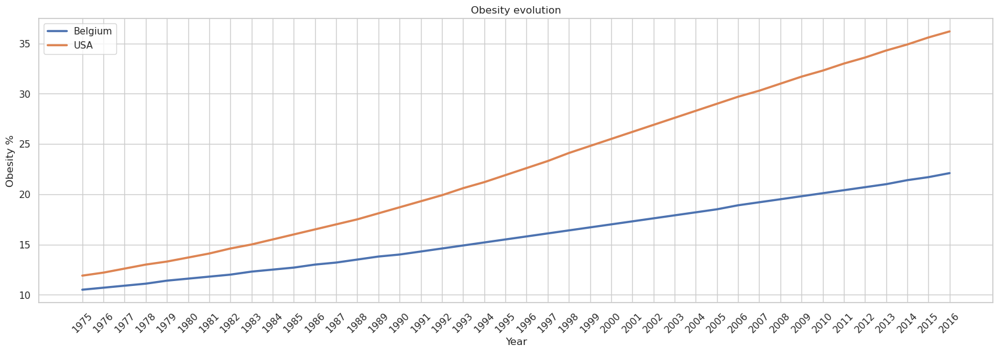

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(20, 6))
sns.set()
sns.set_style("whitegrid")
sns.set_context("notebook", font_scale=1, rc={"lines.linewidth": 2.5})

sns.lineplot(x=x, y=y_bel, label='Belgium')
sns.lineplot(x=x, y=y_us, label='USA')


plt.xlabel('Year')
plt.ylabel('Obesity %')
plt.title('Obesity evolution')
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Show the plot
plt.show()

Obesitas is sterk aan het toenemen. Voor de vergelijkking met de Mcdonalds data ga ik enkel de meest recentelijke obesity data gebruiken, sinds ik geen historische data van McDonalds heb.

#### - Obesitas per land

In [31]:
def fix_rdd(x):
    try:
        return float(x)
    except:
        return -1
    
def rename(x):
    if x == "United States of America":
        return "United States"
    if x == "United Kingdom of Great Britain and Northern Ireland":
        return "United Kingdom"
    else:
        return x

In [33]:

obesity_by_country = obesity.rdd.filter(lambda l: 'Both sexes' in l['Sex'])\
                            .filter(lambda l: '2016' in l['Year'])\
                            .map(lambda l: (rename(l['Country']), l['Year'], fix_rdd(l['Obesity (%)'].split(" ")[0]), l['Sex']))\
                            .filter(lambda l: l[2] != -1)


In [18]:
countries_with_mcdonalds = mcdonalds_count.rdd.map(lambda l: l[0])
countries_with_mcdonalds = countries_with_mcdonalds.collect()

In [69]:
obesity_in_mccountries = obesity_by_country.filter(lambda l: l[0]in countries_with_mcdonalds)
obesity_in_mccountries.take(10)

[('Andorra', '2016', 25.6, 'Both sexes'),
 ('Argentina', '2016', 28.3, 'Both sexes'),
 ('Australia', '2016', 29.0, 'Both sexes'),
 ('Austria', '2016', 20.1, 'Both sexes'),
 ('Azerbaijan', '2016', 19.9, 'Both sexes'),
 ('Bahamas', '2016', 31.6, 'Both sexes'),
 ('Bahrain', '2016', 29.8, 'Both sexes'),
 ('Belarus', '2016', 24.5, 'Both sexes'),
 ('Belgium', '2016', 22.1, 'Both sexes'),
 ('Brazil', '2016', 22.1, 'Both sexes')]

## Datasets samenvoegen

Ik moet het aantal McDonalds per ... inwoners uitrekenen om een eerlijke vergelijking te maken.

In [35]:
population = spark.read.format('csv').option('header', 'true').load('./data/population_by_country_2020.csv').select("Country (or dependency)", "Population (2020)")
population_countries_with_mcdonalds = population.rdd.filter(lambda l: l['Country (or dependency)'] in countries_with_mcdonalds)\
                                          .map(lambda l: (l['Country (or dependency)'], int(l['Population (2020)'])))

population_countries_with_mcdonalds = spark.createDataFrame(population_countries_with_mcdonalds)\
                                 .withColumnRenamed("_1", "country") \
                                 .withColumnRenamed("_2", "population")

In [67]:
mcdonalds_with_population = mcdonalds_count.join(population_countries_with_mcdonalds, "country","inner")
mcdonalds_with_population.show(10)

+-------------+---------------+----------+
|      country|mcdonalds_count|population|
+-------------+---------------+----------+
|        China|           5906|1440297825|
|        India|            407|1382345085|
|United States|          12419| 331341050|
|    Indonesia|            297| 274021604|
|     Pakistan|             71| 221612785|
|       Brazil|           1052| 212821986|
|       Russia|            863| 145945524|
|       Mexico|            229| 129166028|
|        Japan|           2963| 126407422|
|  Philippines|            654| 109830324|
+-------------+---------------+----------+
only showing top 10 rows



In [37]:
from pyspark.sql.functions import expr
mcdonalds_with_population_count = mcdonalds_with_population.withColumn("mcdonalds_per_100k_inhabitants", expr("mcdonalds_count / (population / 100000)"))
mcdonalds_with_population_count_rdd = mcdonalds_with_population_count.rdd.map(lambda l: (l['country'], l['population'], l['mcdonalds_count'], round(float(l['mcdonalds_per_100k_inhabitants']), 2)))\
                                                                         .sortBy(lambda l: l[3], ascending=False)
mcdonalds_with_population_count_df = spark.createDataFrame(mcdonalds_with_population_count_rdd)\
                                          .withColumnRenamed("_1", "country") \
                                          .withColumnRenamed("_2", "population")\
                                          .withColumnRenamed("_3", "mcdonalds_count")\
                                          .withColumnRenamed("_4", "mcdonalds_per_100k_inhabitants")
mcdonalds_with_population_count_df.show(10)

+-------------+----------+---------------+------------------------------+
|      country|population|mcdonalds_count|mcdonalds_per_100k_inhabitants|
+-------------+----------+---------------+------------------------------+
|      Andorra|     77287|              5|                          6.47|
|    Australia|  25550683|           1014|                          3.97|
|United States| 331341050|          12419|                          3.75|
|       Canada|  37799407|           1408|                          3.72|
|  New Zealand|   4829021|            170|                          3.52|
|        Aruba|    106845|              3|                          2.81|
|Liechtenstein|     38147|              1|                          2.62|
|       Israel|   8678517|            221|                          2.55|
|       Monaco|     39290|              1|                          2.55|
|       France|  65298930|           1597|                          2.45|
+-------------+----------+------------

Nu kan ik de datasets gaan samenvoegen.

In [66]:
obesity_in_mccountries_df = spark.createDataFrame(obesity_in_mccountries)\
                                 .drop("_2", "_4")\
                                 .withColumnRenamed("_1", "country") \
                                 .withColumnRenamed("_3", "obesity %")

In [39]:
final_data = obesity_in_mccountries_df.join(mcdonalds_with_population_count_df, "country","inner")\
                                      .orderBy("obesity %", ascending=False)

In [61]:
from IPython.display import display, clear_output
import ipywidgets as widgets
import pandas as pd

final_data_pandas = final_data.toPandas()

column_dropdown = widgets.Dropdown(
    options=final_data_pandas.columns,
    value=final_data_pandas.columns[4],
    description='Select Column:',
)

def on_dropdown_change(change):
    selected_column = change['new']
    sorted_df = final_data_pandas.sort_values(by=selected_column, ascending=False)

    clear_output(wait=True)
    display(column_dropdown)
    pd.set_option('display.max_rows', 100)
    display(sorted_df)

column_dropdown.observe(on_dropdown_change, names='value')

display(column_dropdown)
on_dropdown_change({'new': final_data_pandas.columns[4]})


Dropdown(description='Select Column:', index=3, options=('country', 'obesity %', 'population', 'mcdonalds_coun…

,country,obesity %,population,mcdonalds_count,mcdonalds_per_100k_inhabitants
2,United States,36.2,331341050,12419,3.75
79,China,6.2,1440297825,5906,0.41
82,Japan,4.3,126407422,2963,2.34
54,France,21.6,65298930,1597,2.45
47,Germany,22.3,83830972,1416,1.69
21,United Kingdom,27.8,67948282,1416,2.08
13,Canada,29.4,37799407,1408,3.72
51,Brazil,22.1,212821986,1052,0.49
14,Australia,29.0,25550683,1014,3.97
68,Italy,19.9,60446035,674,1.12


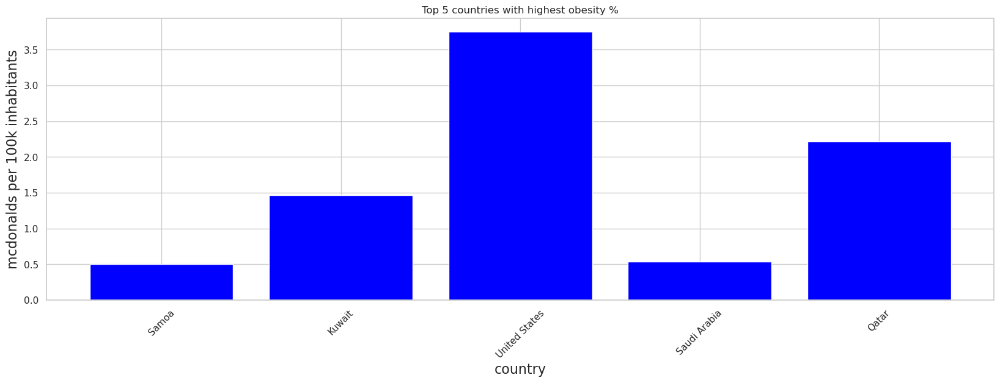

In [62]:
top_df = final_data_pandas.sort_values(by='obesity %', ascending=False)


top5_df = top_df.head(5)

plt.figure(figsize=(20, 6)) 
plt.bar(top5_df['country'], top5_df['mcdonalds_per_100k_inhabitants'], color='blue')


plt.title('Top 5 countries with highest obesity %')
plt.xlabel('country', fontsize=16)
plt.ylabel('mcdonalds per 100k inhabitants', fontsize=16)
plt.xticks(rotation=45)  

plt.show()

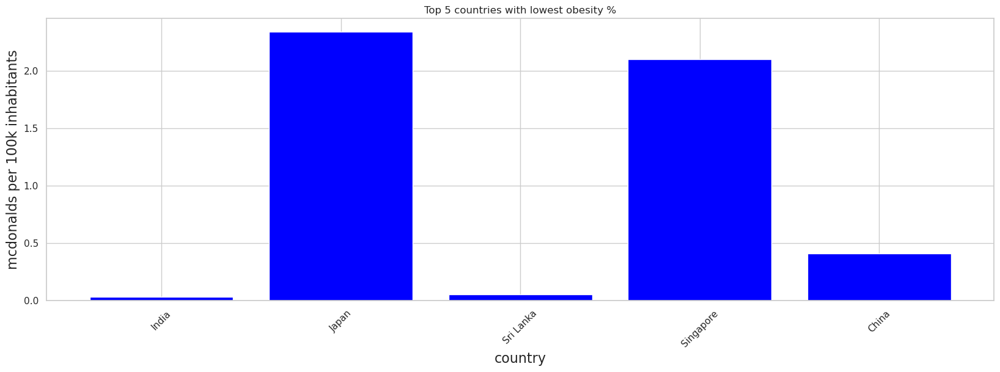

In [65]:
lowest_df = final_data_pandas.sort_values(by='obesity %')


lowest5_df = lowest_df.head(5)

plt.figure(figsize=(20, 6)) 
plt.bar(lowest5_df['country'], lowest5_df['mcdonalds_per_100k_inhabitants'], color='blue')


plt.title('Top 5 countries with lowest obesity %')
plt.xlabel('country', fontsize=16)
plt.ylabel('mcdonalds per 100k inhabitants', fontsize=16)
plt.xticks(rotation=45)  

plt.show()

In [100]:
asian_countries = spark.read.format('csv').option('header', 'true').load('./data/AsiaPopulation2020.csv')
asian_countries = asian_countries.rdd.map(lambda l: l[0]).collect()

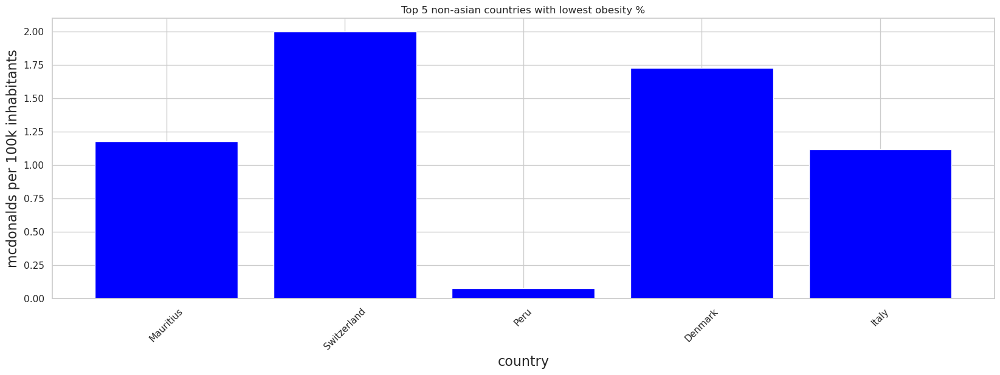

In [102]:
from pyspark.sql.functions import col

final_data_no_asia = final_data.filter(~col('country').isin(asian_countries))
final_data_no_asia_pandas = final_data_no_asia.toPandas()

lowest__no_asia_df = final_data_no_asia_pandas.sort_values(by='obesity %')
lowest5_no_asia_df = lowest__no_asia_df.head(5)

plt.figure(figsize=(20, 6)) 
plt.bar(lowest5_no_asia_df['country'], lowest5_no_asia_df['mcdonalds_per_100k_inhabitants'], color='blue')


plt.title('Top 5 non-asian countries with lowest obesity %')
plt.xlabel('country', fontsize=16)
plt.ylabel('mcdonalds per 100k inhabitants', fontsize=16)
plt.xticks(rotation=45)  

plt.show()